# Denoising Project
Majid Dareini

First of all, we import all libraries needed.

In [1]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import math
import numpy.fft as fft
import pywt
import pyshearlab
import os

/home/majiddrn/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "
/usr/lib/python3/dist-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.17.3 and <1.25.0 is required for this version of SciPy (detected version 1.26.2
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


To load each group of images, we simply load each one group in an array.

In [2]:
def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img = cv.imread(os.path.join(folder,filename), 0)
        if img is not None:
            images.append(img)
    return images

The directories the images will be loaded from are the follow.

In [3]:
med_dir = 'DS/Med'
normal_dir = 'DS/Normal'
rs_dir = 'DS/RS'

Now, let's load the images.

In [4]:
med_images = load_images_from_folder(med_dir)
normal_images = load_images_from_folder(normal_dir)
rs_images = load_images_from_folder(rs_dir)

Then, we'll have a map to store each denoising approach for every noise.

In [50]:
gaussianNoise_results = {}
poissonNoise_results = {}
speckleNoise_results = {}
saltAndPepper_results = {}

Now, let's discuss about the noises and the best solution for each.

Now I bring the implementation of `PSNR` and `SSIM` quality metrics.

In [5]:
def calculate_psnr(img1, img2):
    # img1 and img2 have range [0, 255]
    img1 = img1.astype(np.float64)
    img2 = img2.astype(np.float64)
    mse = np.mean((img1 - img2)**2)
    if mse == 0:
        return float('inf')
    return 20 * math.log10(255.0 / math.sqrt(mse))

def ssim(img1, img2):
    C1 = (0.01 * 255)**2
    C2 = (0.03 * 255)**2

    img1 = img1.astype(np.float64)
    img2 = img2.astype(np.float64)
    kernel = cv.getGaussianKernel(11, 1.5)
    window = np.outer(kernel, kernel.transpose())

    mu1 = cv.filter2D(img1, -1, window)[5:-5, 5:-5]  # valid
    mu2 = cv.filter2D(img2, -1, window)[5:-5, 5:-5]
    mu1_sq = mu1**2
    mu2_sq = mu2**2
    mu1_mu2 = mu1 * mu2
    sigma1_sq = cv.filter2D(img1**2, -1, window)[5:-5, 5:-5] - mu1_sq
    sigma2_sq = cv.filter2D(img2**2, -1, window)[5:-5, 5:-5] - mu2_sq
    sigma12 = cv.filter2D(img1 * img2, -1, window)[5:-5, 5:-5] - mu1_mu2

    ssim_map = ((2 * mu1_mu2 + C1) * (2 * sigma12 + C2)) / ((mu1_sq + mu2_sq + C1) *
                                                            (sigma1_sq + sigma2_sq + C2))
    return ssim_map.mean()


def calculate_ssim(img1, img2):
    '''calculate SSIM
    the same outputs as MATLAB's
    img1, img2: [0, 255]
    '''
    if not img1.shape == img2.shape:
        raise ValueError('Input images must have the same dimensions.')
    if img1.ndim == 2:
        return ssim(img1, img2)
    elif img1.ndim == 3:
        if img1.shape[2] == 3:
            ssims = []
            for i in range(3):
                ssims.append(ssim(img1, img2))
            return np.array(ssims).mean()
        elif img1.shape[2] == 1:
            return ssim(np.squeeze(img1), np.squeeze(img2))
    else:
        raise ValueError('Wrong input image dimensions.')

Code implementation credit: [CV Notes](https://cvnote.ddlee.cc/2019/09/12/psnr-ssim-python)

## Noise

Noise usually stands for a random variation in the brightness or color of the image. In the case of digital images, noise can be produced due to different reasons:

+ The image sensor is broken or affected by external factors

+ Lack of light or overheating of the device at the moment of taking a photo;

+ Interference of the transmission channel, and so on

The noise might be added or multiplied to the image. <br/>
Here is the formula for the Additive Noise Model, where:

+ x and y are the coordinates of the pixel to which the noise is applied

+ s(x, y) is the intensity of the original image

+ n(x, y) is the noise added to the original image

+ w(x,y) is the distorted image received after the noise is applied

$$
w(x,y) = s(x, y) + n(x, y)
$$

Definition credit: [Wiki-Cloudfactory](https://wiki.cloudfactory.com/docs/mp-wiki/augmentations/gaussian-noise)

### Gaussian Noise
Gaussian Noise is a statistical noise with a Gaussian (normal) distribution. It means that the noise values are distributed in a normal Gaussian way. <br/>
The probability density function $p$ of a Gaussian random variable $z$ is as follow.
$$
\psi(z) = \frac{1}{\sqrt{2\pi\sigma^2}} e^{-\frac{(z-\mu)^2}{2\sigma^2}}
$$ 
Now, firstly, let's implement a function for Gaussian noise application.

In [6]:
def apply_GaussianNoise(image, mean, sigma):
    rows, cols = image.shape
    var = 0.1
    gauss = np.random.normal(mean, sigma, (rows, cols))
    gauss = gauss.reshape(rows, cols)
    
    return cv.add(image, gauss, dtype=cv.CV_32F)

And then application of gaussian noise to every image of a set.

In [7]:
def apply_GaussianNoise__set(images, mean, sigma):
    images_ = []
    for img in images:
        images_.append(apply_GaussianNoise(img, mean, sigma))
    
    return images_

First, we apply the gaussian noise to `Med` images. Before that, we implement a function to this simpler.

In [8]:
def plot_images(images1, images2=None):
    len1 = len(images1)
    if (images2 != None):
        len2 = len(images2)
    
    if (images2 != None):
        if len1 != len2:
            raise ValueError("Both image lists must have the same length.")
    
    dim = math.ceil(math.sqrt(len1)) 

    fig, axes = plt.subplots(dim, dim, figsize=(24, 20))
    axes = axes.ravel()

    psnr_values = []
    ssim_values = []

    for i in range(len1):
        axes[i].imshow(images1[i], cmap='gray')
        axes[i].axis('off')
        if (images2 != None):
            psnr_value = calculate_psnr(images1[i], images2[i])
            ssim_value = calculate_ssim(images1[i], images2[i])
            axes[i].set_title('PSNR: {:.2f}, SSIM: {:.2f}'.format(psnr_value, ssim_value))
            psnr_values.append(psnr_value)
            ssim_values.append(ssim_value)
        
    for j in range(i+1, dim*dim):
        fig.delaxes(axes[j])

    plt.subplots_adjust(wspace=0.5, hspace=0.5)
    
    if (images2 != None):
        return sum(psnr_values) / len1, sum(ssim_values) / len1

First see the dataset itself.

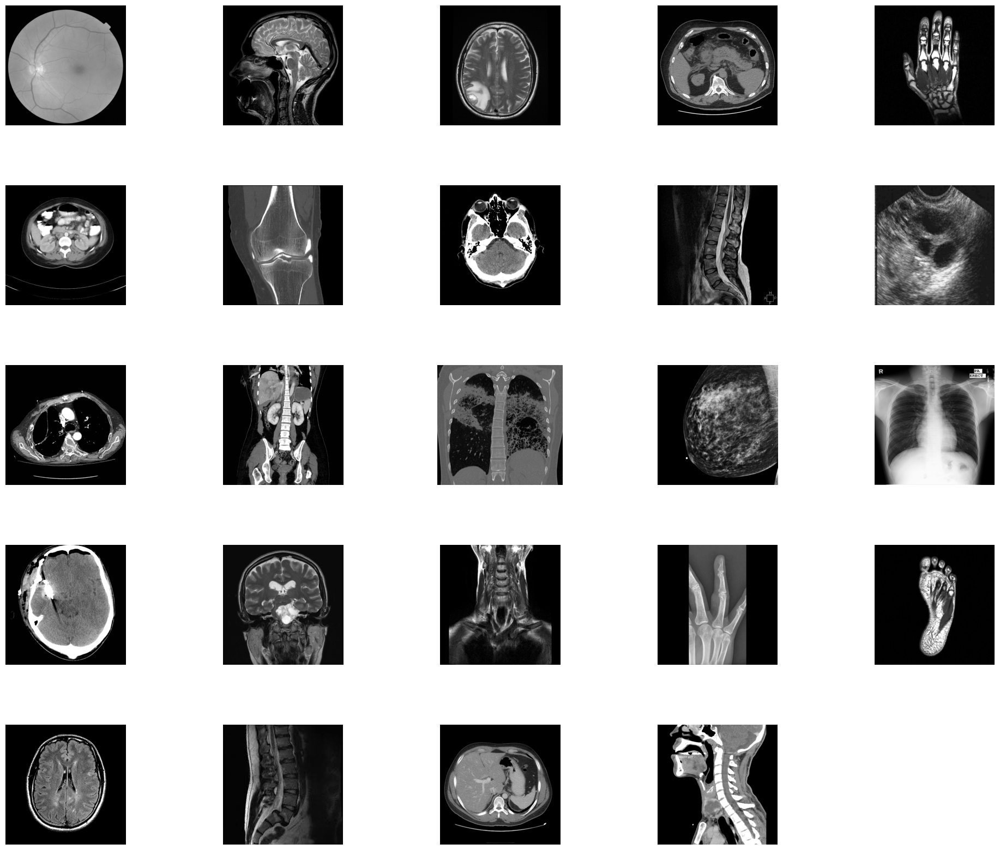

In [9]:
plot_images(med_images)

Now, let's apply the noise with $\sigma = 40$ and $\mu = 0$.

In [10]:
meds__gaussianNoise = apply_GaussianNoise__set(med_images, 0, 40)

Well, now let's plot them.

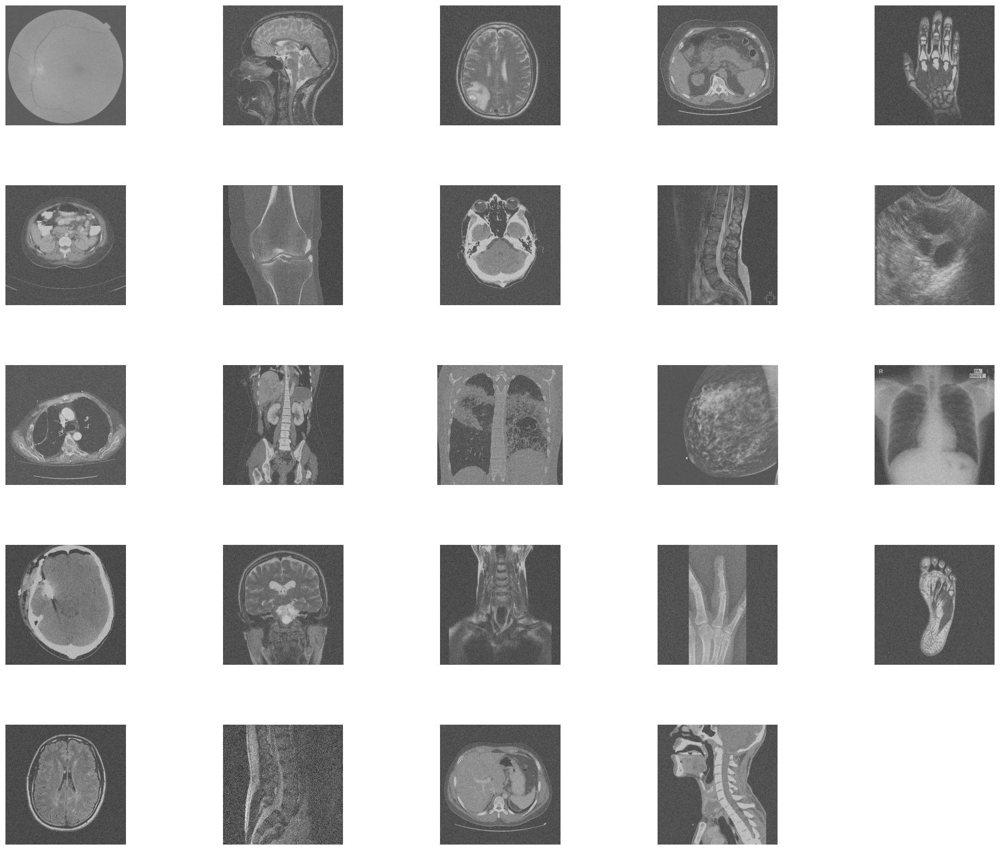

In [11]:
plot_images(meds__gaussianNoise)

Now, we should try to remove the noises by the filters stated in the document. <br/>

Firstly, let's try by smoothing filters in order of `median`, `blur`, `bilateral`.

For more convenience, we implement a function for each as we did for gaussian.

In [12]:
def median_filter(image, kernel_size=3):
    return cv.medianBlur(image.astype('uint8'), kernel_size)

def apply_median_filter_to_list(images_list, kernel_size=3):
    return [median_filter(image, kernel_size) for image in images_list]


In [13]:
def gaussian_blur(image, kernel_size=(5,5)):
    return cv.GaussianBlur(image, kernel_size, 0)

def apply_gaussian_blur_to_list(images_list, kernel_size=(5,5)):
    return [gaussian_blur(image, kernel_size) for image in images_list]


In [14]:
def bilateral_filter(image, d=15, sigmaColor=75, sigmaSpace=75):
    return cv.bilateralFilter(image.astype('uint8'), d, sigmaColor, sigmaSpace)

def apply_bilateral_filter_to_list(images_list, d=15, sigmaColor=75, sigmaSpace=75):
    return [bilateral_filter(image, d, sigmaColor, sigmaSpace) for image in images_list]


In [15]:
# def shearlet_transform_reconstruction(image_filename, scale_num, shearlet_num):
#     # Load the image
#     image = cv.imread(image_filename, cv.IMREAD_GRAYSCALE)

#     # Set up parameters for the shearlet transform
#     rows, cols = image.shape
#     shearLevels = [scale_num]
#     full = 0
#     directionalFilter = 'Shearlab.filter1d'
#     sideFilter = 'Shearlab.filter1d'

#     # Compute the shearlet system
#     # shearletSystem = pyshearlab.SLgetShearletSystem2D(False, rows=rows, cols=cols, nScales=10),
#     # shearletSystem = pyshearlab.SLgetShearletSystem2D(rows, cols, shearLevels, full, directionalFilter, sideFilter)
#     shearletSystem = pyshearlab.SLgetShearletSystem2D(useGPU=0,rows=rows, cols=cols, nScales=2, shearLevels=[2, 2], directionalFilter=2, full=1)

#     # Compute the shearlet coefficients
#     coefficients = pyshearlab.SLsheardec2D(image, shearletSystem)

#     # Select a specific shearlet
#     coefficients[:, :, shearlet_num] = 0

#     # Reconstruct the image
#     rec_image = pyshearlab.SLshearrec2D(coefficients, shearletSystem)

#     # Normalize the image for OpenCV
#     rec_image_normalized = cv.normalize(rec_image, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F).astype(np.uint8)
    
#     # Show the image with OpenCV
#     cv.imshow('Reconstructed Image', rec_image_normalized)
#     cv.waitKey(0)
#     cv.destroyAllWindows()

# # Test the function
# shearlet_transform_reconstruction("DS/Med/1.png", 3, 2)

Now, let's apply the above filters on our noised images.

In [16]:
meds__gaussianBlur5 = apply_gaussian_blur_to_list(meds__gaussianNoise, (5, 5))
meds__gaussianBlur9 = apply_gaussian_blur_to_list(meds__gaussianNoise, (9, 9))

meds__median3 = apply_median_filter_to_list(meds__gaussianNoise, 3)
meds__median7 = apply_median_filter_to_list(meds__gaussianNoise, 7)

meds__bilateral75_75 = apply_bilateral_filter_to_list(meds__gaussianNoise)
meds__bilateral95_95 = apply_bilateral_filter_to_list(images_list=meds__gaussianNoise, d=15, sigmaColor=95, sigmaSpace=95)

Well, now let's plot denoised images.

First of all, let's plot the result of gaussian blurring on gaussian noised images with $5 \times 5$ and $9 \times 9$ kernel.

(26.05517141287756, 0.45244528151628316)

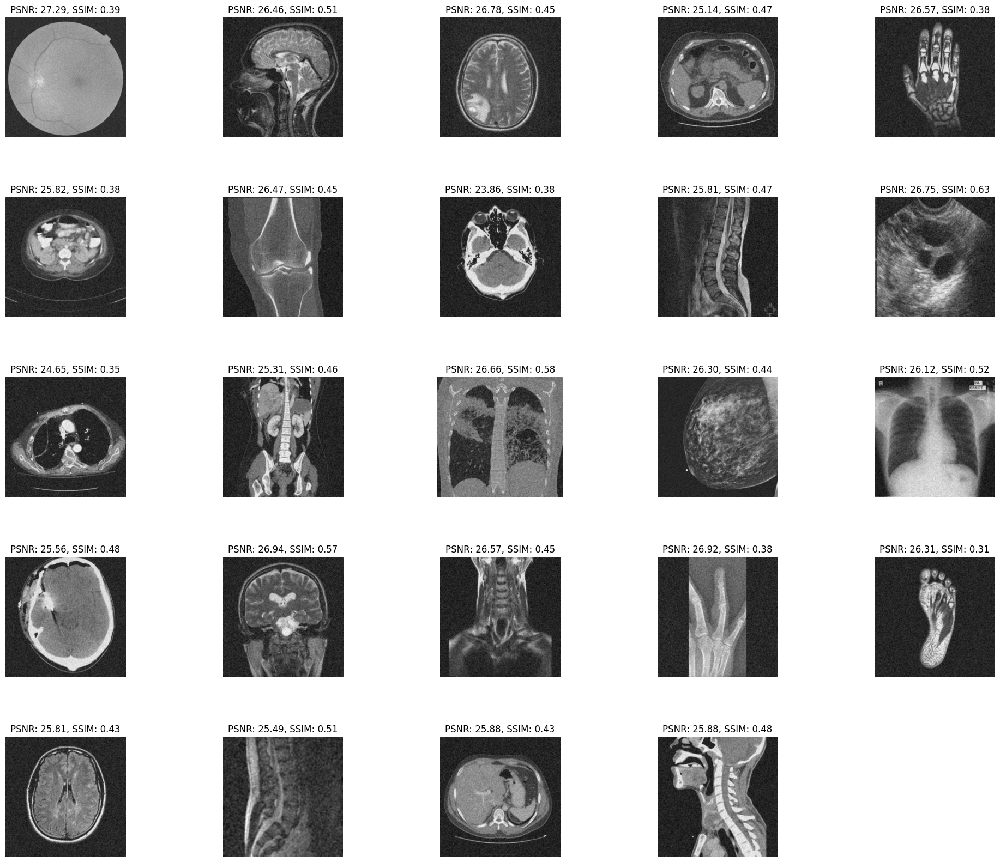

In [17]:
psnr, ssim = plot_images(meds__gaussianBlur5, med_images)

(26.79027825507953, 0.5655059611263263)

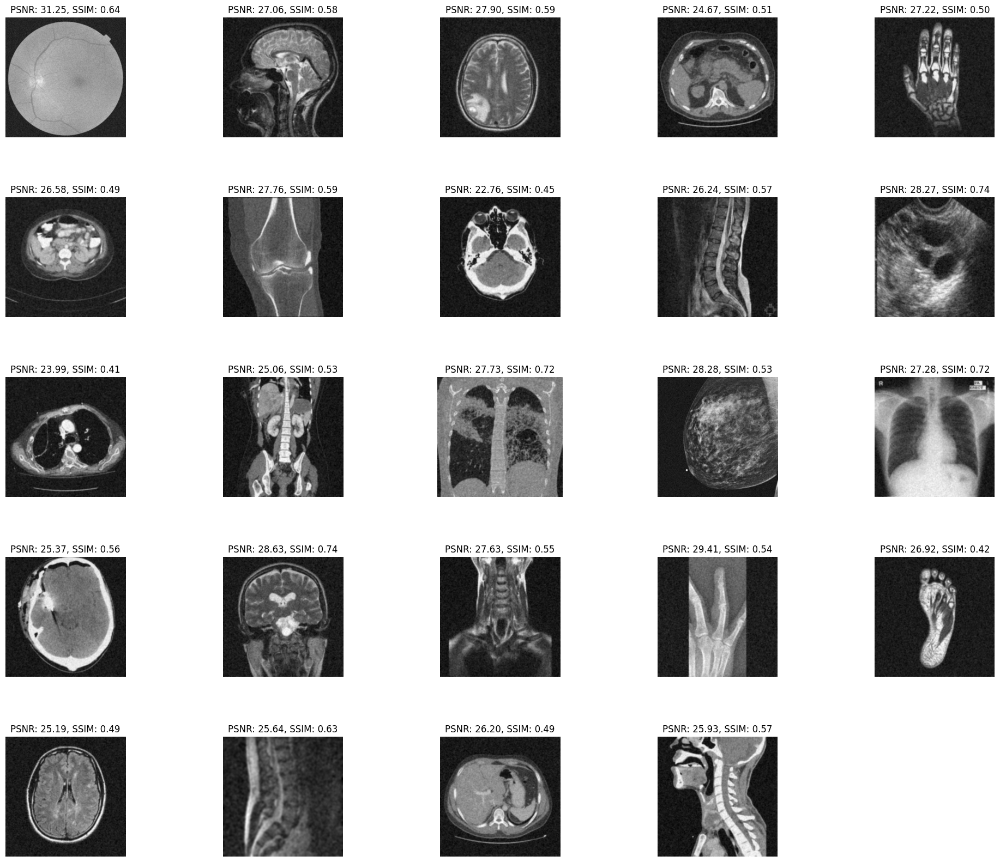

In [18]:
plot_images(meds__gaussianBlur9, med_images)

Well, we saw the gaussian blurring can smooth the noises. Even as we increase the size of the kernel, the noises disappear more. But it doesn't remove the noises completely!

Well, Now let's plot the application of `median` filter with kernels with size of $3 \times 3$ and $7 \times 7$.

(8.748833887873372, 0.18541219420036462)

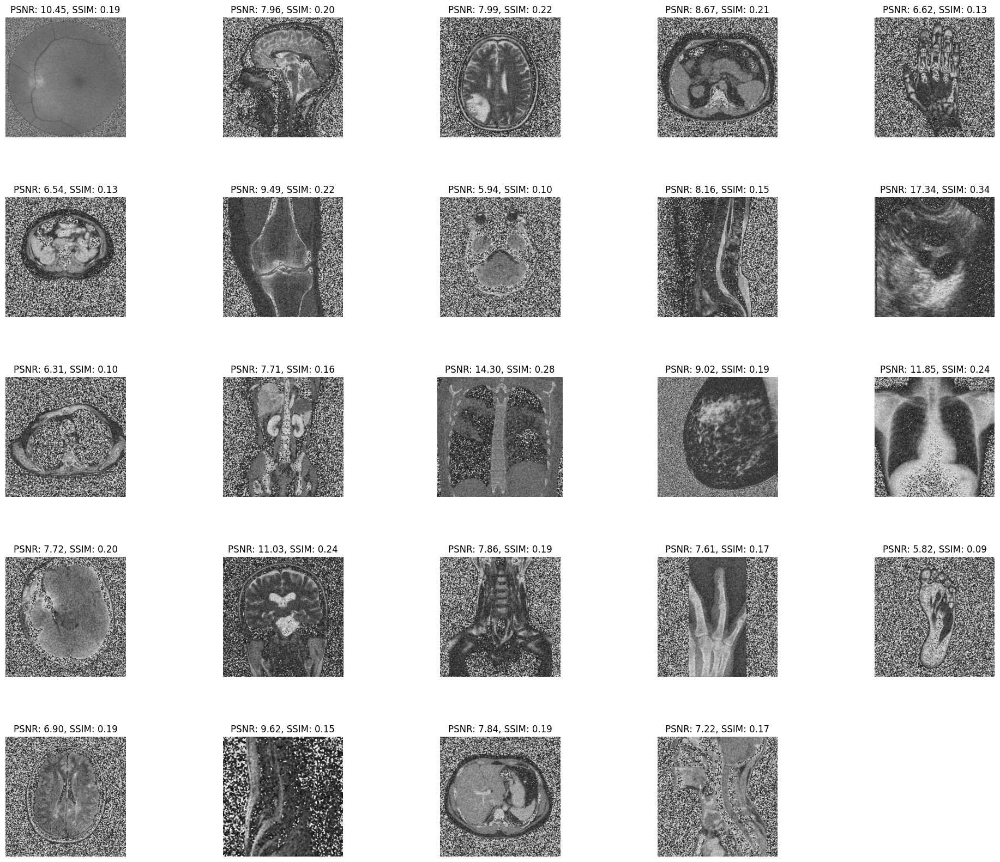

In [19]:
plot_images(meds__median3, med_images)

(10.29576053677939, 0.2770913782857964)

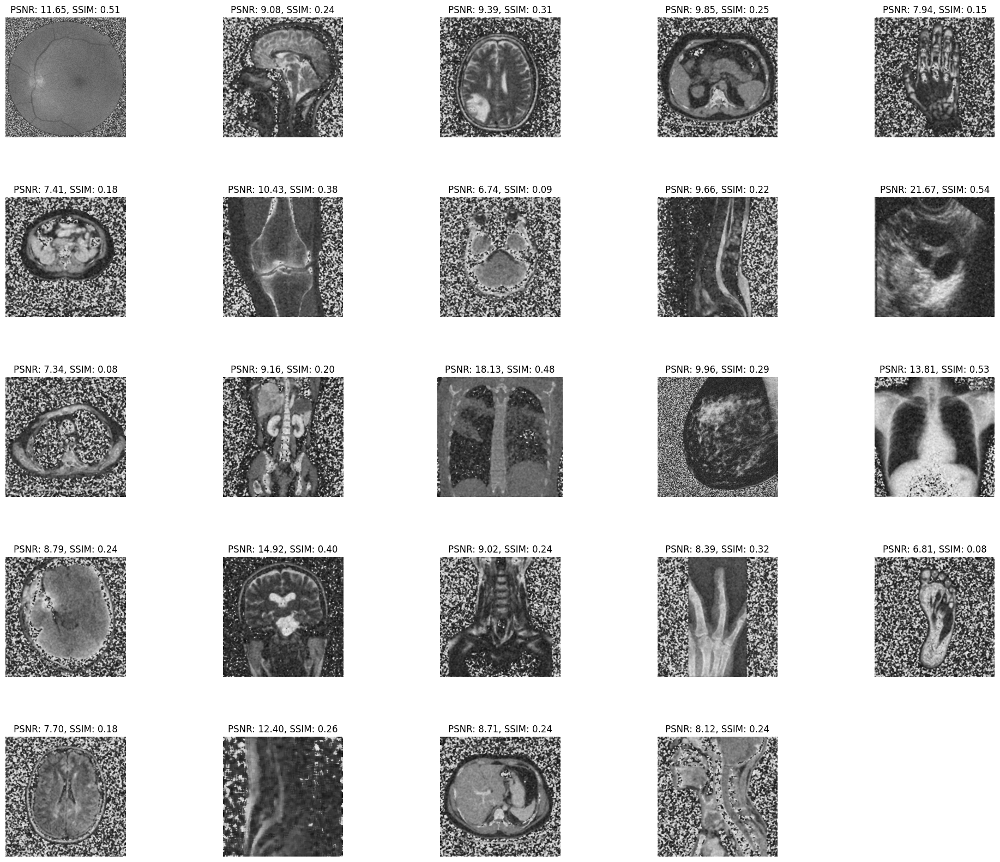

In [20]:
plot_images(meds__median7, med_images)

As we saw, `median` filter can not be a good option to remove gaussian noise. This filter generates more additional pixels with abandance of unwanted intensities which lead the image to destruction.

Now, let's apply bilateral filter with different sigmas.

(7.789105559316436, 0.13766793808379557)

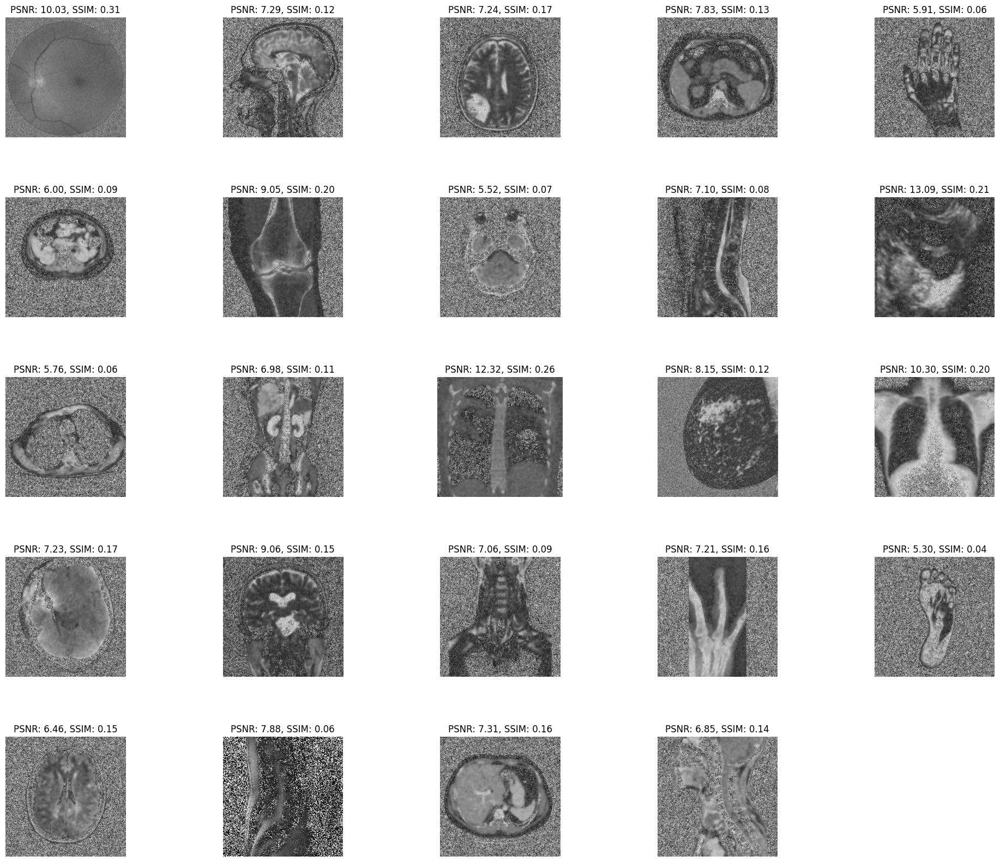

In [21]:
plot_images(meds__bilateral75_75, med_images)

(8.37669376632933, 0.1655683231191523)

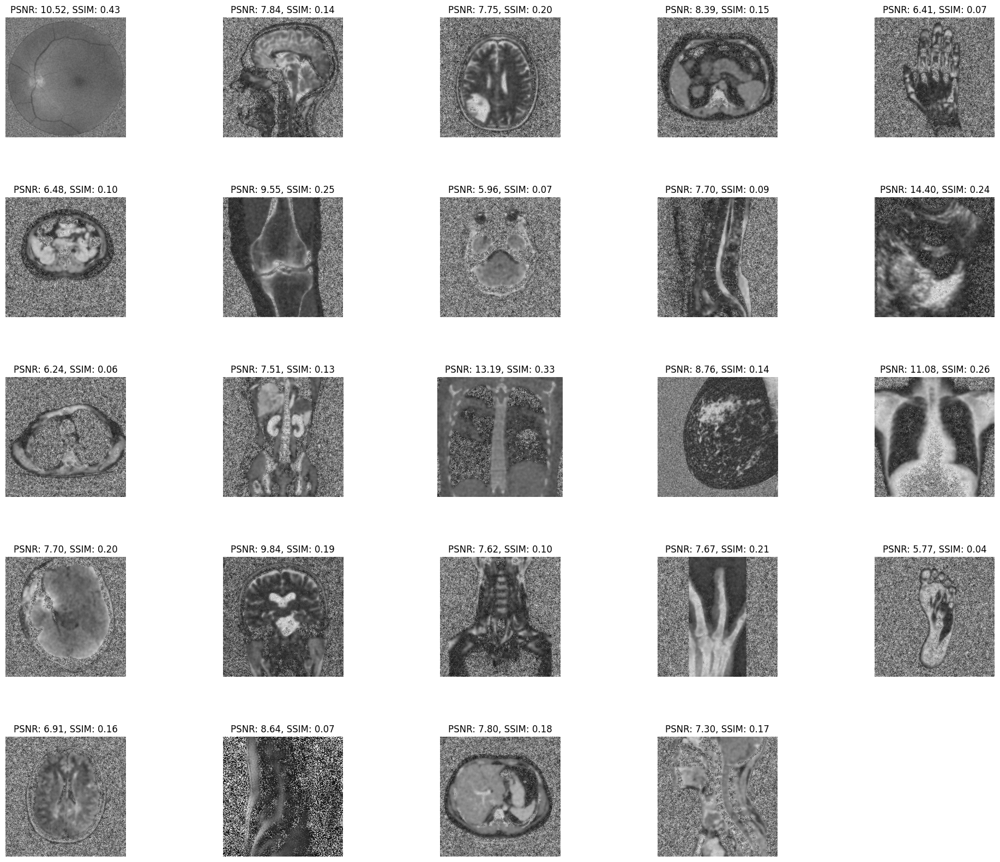

In [22]:
plot_images(meds__bilateral95_95, med_images)

As we see, `bilateral` gives a result similar to `median` filter which leads to destruction of the image.

Now, let's apply sharpenning filters such as `Laplacian`, `Sobel`, `Robert`, `High-pass`, `Unsharp Masking`. As before, we implement functions for each for more convenience.

In [23]:
def apply_laplacian(image, ddepth=cv.CV_32F, ksize=5):
    return cv.Laplacian(image, ddepth, ksize)

def apply_laplacian_to_list(images_list, ddepth=cv.CV_32F, ksize=5):
    return [apply_laplacian(image, ddepth, ksize) for image in images_list]

In [24]:
def apply_sobel_horizontal(image, ddepth=cv.CV_32F, ksize=3):
    return cv.Sobel(image, ddepth, dx=1, dy=0, ksize=ksize)

def apply_sobel_horizontal_to_list(images_list, ddepth=cv.CV_32F, ksize=3):
    return [apply_sobel_horizontal(image, ddepth, ksize) for image in images_list]

def apply_sobel_vertical(image, ddepth=cv.CV_32F, ksize=3):
    return cv.Sobel(image, ddepth, dx=0, dy=1, ksize=ksize)

def apply_sobel_vertical_to_list(images_list, ddepth=cv.CV_32F, ksize=3):
    return [apply_sobel_vertical(image, ddepth, ksize) for image in images_list]

def apply_highpass_fft(image):
    F = fft.fft2(image)
    F_shift = fft.fftshift(F)
    rows, cols = image.shape
    crow, ccol = int(rows/2) , int(cols/2)
    mask = np.ones((rows,cols),np.uint8)
    r = 80
    center = [crow, ccol]
    x, y = np.ogrid[:rows, :cols]
    mask_area = (x - center[0])**2 + (y - center[1])**2 <= r*r
    mask[mask_area] = 0
    F_shift = F_shift*mask
    f_ishift = fft.ifftshift(F_shift)
    img_back = fft.ifft2(f_ishift)
    img_back = np.abs(img_back)
    return img_back

def apply_highpass_fft_to_list(images_list):
    return [apply_highpass_fft(image) for image in images_list]

def apply_unsharp_mask(image, sigma=1.0, boost=1.5):
    blurred = cv.GaussianBlur(image, (0, 0), sigma)
    sharpened = cv.addWeighted(image, 1 + boost, blurred, -boost, 0)
    return sharpened

def apply_unsharp_mask_to_list(images_list, sigma=1.0, boost=1.5):
    return [apply_unsharp_mask(image, sigma, boost) for image in images_list]

In [25]:
def apply_robert(image):
    kernel_x = np.array([[1, 0], [0, -1]], dtype=np.float64)
    kernel_y = np.array([[0, 1], [-1, 0]], dtype=np.float64)
    image_x = cv.filter2D(image, -1, kernel_x)
    image_y = cv.filter2D(image, -1, kernel_y)
    return np.hypot(image_x, image_y)

def apply_robert_to_list(images_list):
    return [apply_robert(image) for image in images_list]

The following functions are some functions which help us in the following processes.

In [26]:
def apply_threshold(image, threshold_value):
    ret, thresh = cv.threshold(image, threshold_value, 255, cv.THRESH_TOZERO)
    return thresh

def apply_threshold_to_list(images_list, threshold_value):
    return [apply_threshold(image, threshold_value) for image in images_list]


def apply_threshold_01(image, threshold_value):
    ret, thresh = cv.threshold(image, threshold_value, 255, cv.THRESH_BINARY_INV)
    
    binary_image = np.where(thresh == 255, 1, 0)
    
    return binary_image

def apply_threshold_01_to_list(images_list, threshold_value):
    return [apply_threshold(image, threshold_value) for image in images_list]


As we know, the above filters can not represent a denoising action by themselves. As a result, we can make a simple apparoach to use them in a way to denoise our images.

I consider the derivated image as `Dimage` and the noised image as `image`. With the help of the following approach, we may have a chance to reach a good approximation in denoising.
$$
Denoisedimage = Threshold(image - (Thresholed01(k \times Dimage, thr01) \times image), thr)
$$
+ `k` is a parameter which sets the strength of noise in Dimage. Obviously if it be more than 1, then it will increase the strength of the noise, otherwise, it will decrease their effects.

+ First step of thresholding with parameter `thr01`, helps us to keep the noises with value of 1.

+ Multiplication of $Thresholed01(...) \times image$ helps to keep the noises.

+ By subtraction of the above step from the noisy image, we'll have most of the noised removed.

+ There may be some noises remained with some specific values which can be removed with the help of last thresholding step with the parameter of `thr`.

In [27]:
def subtract_lists(list1, list2):
    return [a - b for a, b in zip(list1, list2)]

def multiply_lists(list1, list2):
    return [a * b for a, b in zip(list1, list2)]

def multiply_scalar_to_images(images_list, scalar):
    return [image * scalar for image in images_list]


In [28]:
def denoise_derv_set(img, method='laplacian', scalar_k=0.01, thr01=50, thr=10):
    Dimage = None
    if (method == 'laplacian'):
        Dimage = apply_laplacian_to_list(img)
    if (method == 'sobel-horizontal'):
        Dimage = apply_sobel_horizontal_to_list(img)
    if (method == 'sobel-vertical'):
        Dimage = apply_sobel_vertical_to_list(img)
    if (method == 'robert'):
        Dimage = apply_robert_to_list(img)
    if (method == 'high-pass'):
        Dimage = apply_highpass_fft_to_list(img)
    if (method == 'unsharp-masking'):
        Dimage = apply_unsharp_mask_to_list(img)

    k_times_Dimage = multiply_scalar_to_images(Dimage, 0.01)
    k_times_Dimage_thresholed = apply_threshold_01_to_list(k_times_Dimage, 50)
    k_times_Dimage_thresholed_multiplied = multiply_lists(img, k_times_Dimage_thresholed)
    k_times_Dimage_thresholed_multiplied_subtract = subtract_lists(img, k_times_Dimage_thresholed_multiplied)
    denoisedImageSet_subtract = apply_threshold_to_list(k_times_Dimage_thresholed_multiplied_subtract, 10)

    return denoisedImageSet_subtract

In [29]:
denoised_gaussian_laplacian = denoise_derv_set(meds__gaussianNoise, method='laplacian', scalar_k=0.01, thr01=50, thr=10)

(17.502971929033823, 0.14493682245357434)

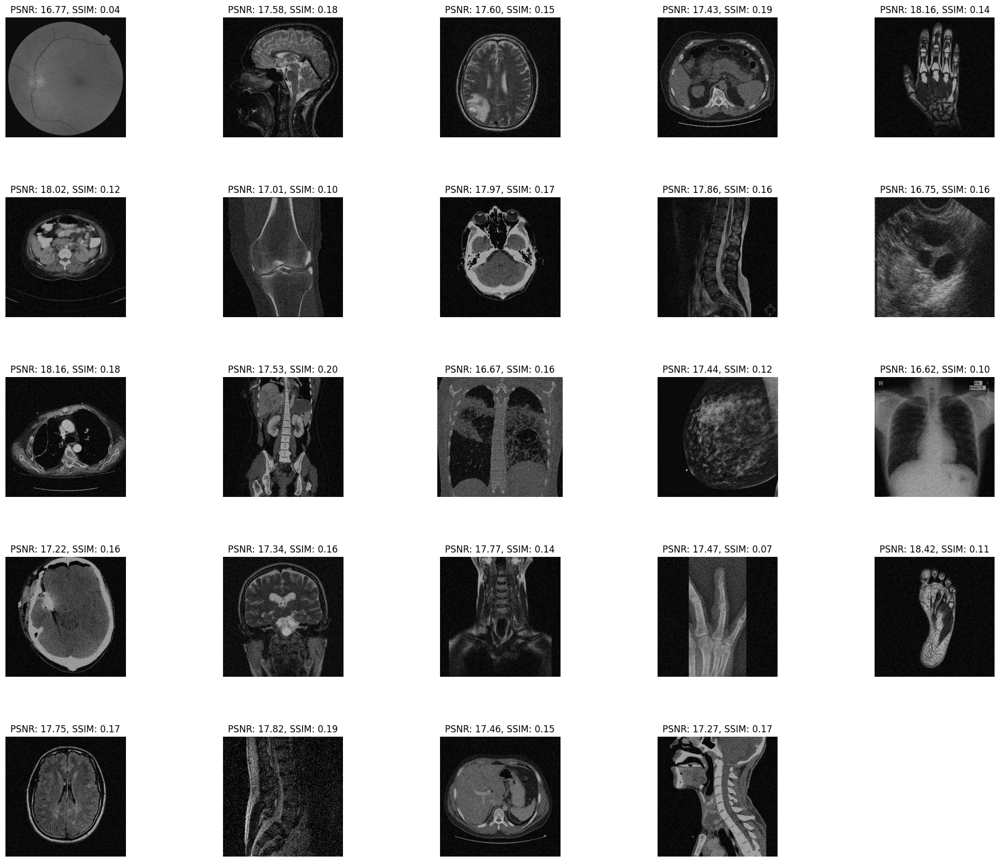

In [30]:
plot_images(denoised_gaussian_laplacian, med_images)

We try a similar appraoch for `Unsharp-masking`, `High-pass`, `Sobel` and `Robert` as we did for `Laplacian`.

In [31]:
denoised_gaussian_high_pass = denoise_derv_set(meds__gaussianNoise, method='high-pass', scalar_k=0.01, thr01=50, thr=10)

(17.502971929033823, 0.14493682245357434)

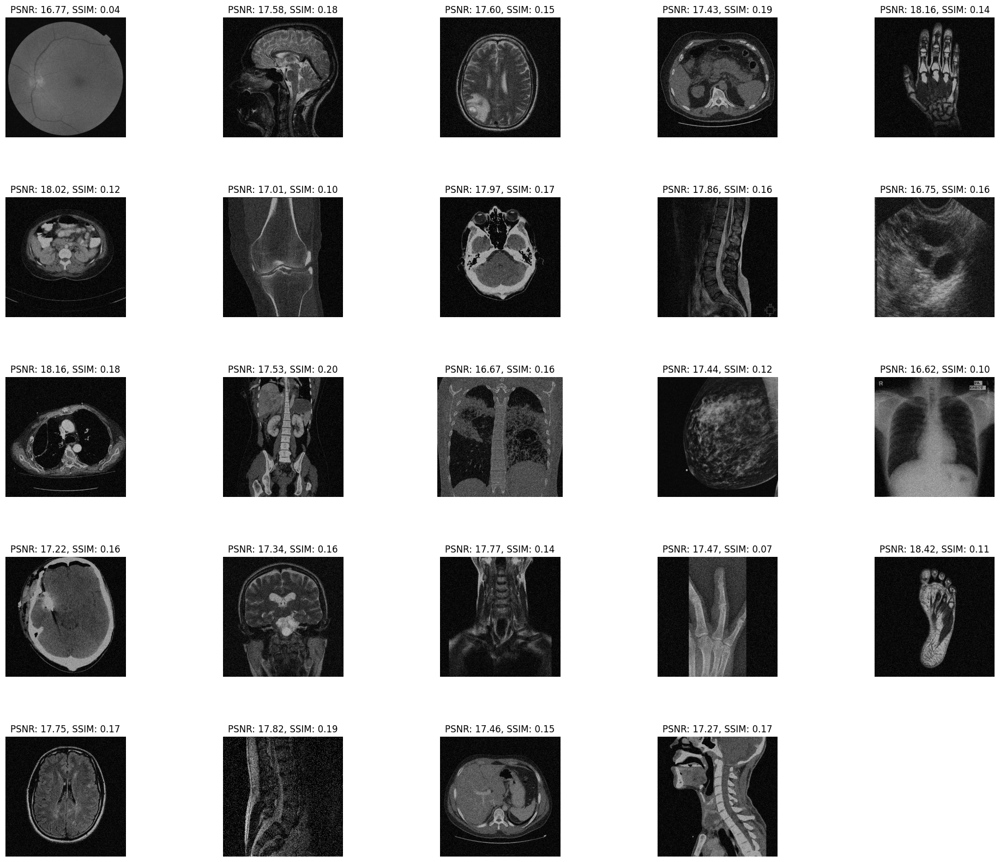

In [32]:
plot_images(denoised_gaussian_high_pass, med_images)

Well, we saw the application of `High-pass` filter as well which is not that bad. Let's try `Unsharp-masking`.

In [33]:
denoised_gaussian_unsharp_masking = denoise_derv_set(meds__gaussianNoise, 'unsharp-masking')

(17.502971929033823, 0.14493682245357434)

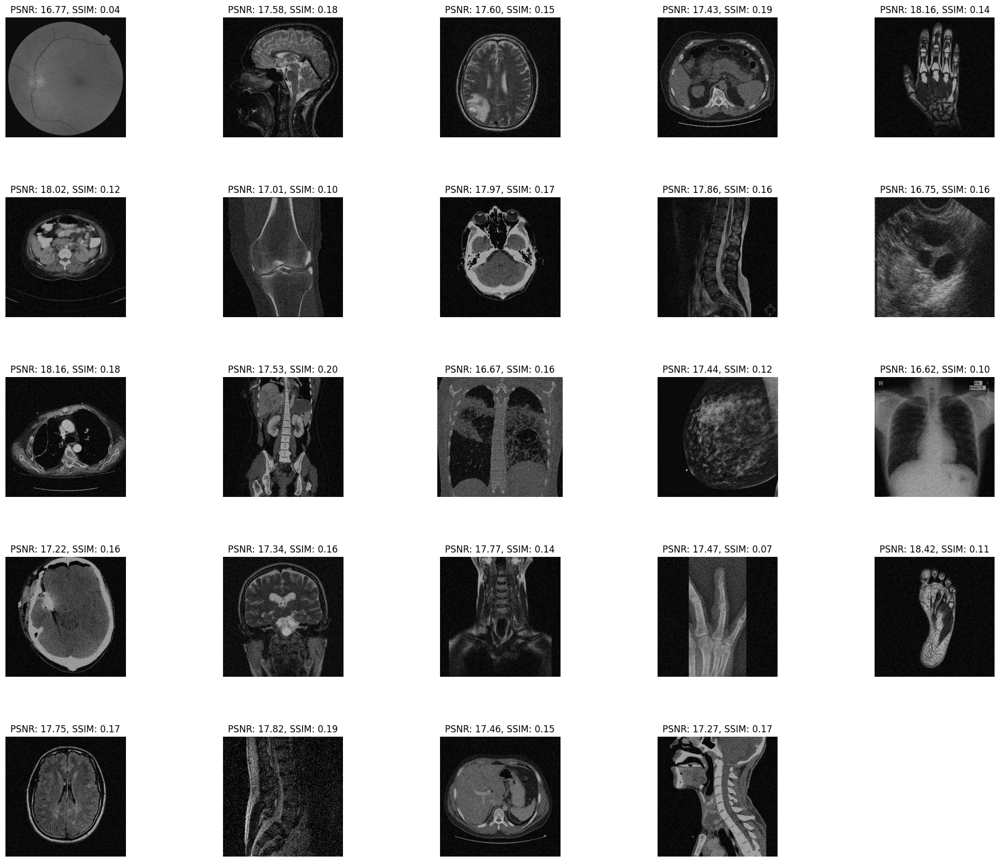

In [34]:
plot_images(denoised_gaussian_unsharp_masking, med_images)

Now let's try `Sobel` first in horizontal an then vertical orientation.

In [35]:
denoised_gaussian_sobel__h = denoise_derv_set(meds__gaussianNoise, 'sobel-horizontal')
denoised_gaussian_sobel__v = denoise_derv_set(meds__gaussianNoise, 'sobel-vertical')

(17.502971929033823, 0.14493682245357434)

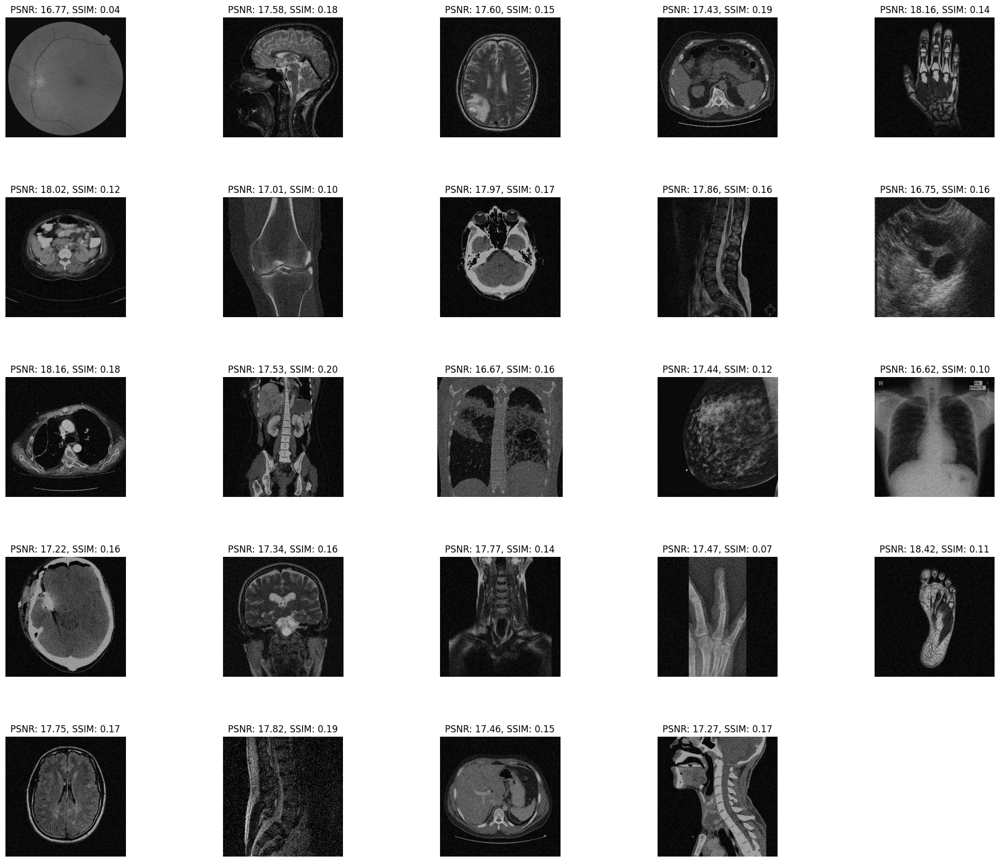

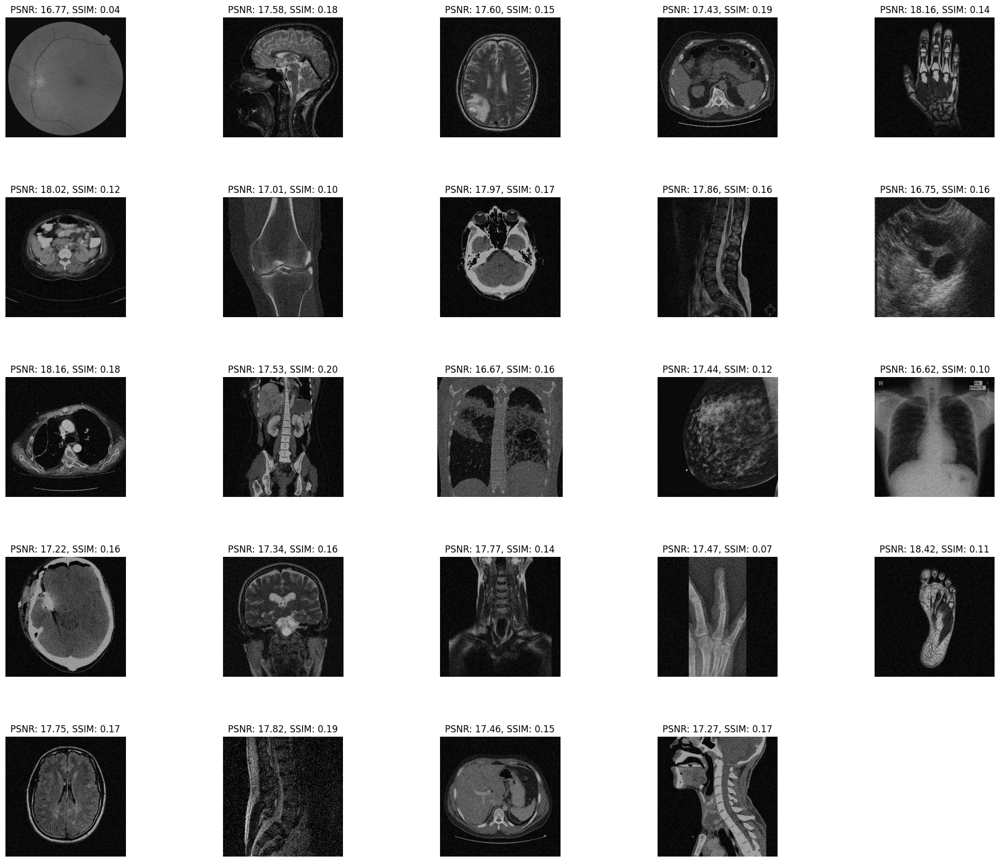

In [36]:
plot_images(denoised_gaussian_sobel__h, med_images)
plot_images(denoised_gaussian_sobel__v, med_images)

Well, now let's try the denoising process with the help of `Wavelet`. First, by `Haar` method, then `Coiflet`, then `Gaussian` and finally `Shannon`.

The denoising process I'll take a hand of is called `Wavelet Thresholding` or `Wavelet Shrinkage`. This method is a known method which is based on Donoho and Johnstone’s work on Wavelet Shrinkage and was first proposed in their paper titled "Ideal spatial adaptation by wavelet shrinkage" (Biometrika, 1994).

The process will be as follow.

+ **Wavelet Transformation**: Let's consider the wavelet of our photo(`image`) as $X(image)$.

+ **Thresholding**: I'll considert the thresholding step as follow $$ Threshold(X(image), thr) $$ which will keep the values greater than `thr`, otherwise, will make them to zero.

+ **Inverse Wavelet Transform**: Finally, we'll calculate the wavelet inverse to reach the denoised image.

The threshold will be calculated as follow:
$$
thr = \sigma \times \sqrt{2 \times \log_2{sizeof(image)}}
$$
Where σ is an estimate of the standard deviation of the noise.

Credit: [DE-NOISING BY SOFT-THRESHOLDING](https://web.stanford.edu/dept/statistics/cgi-bin/donoho/wp-content/uploads/2018/08/denoiserelease3.pdf)

In [46]:
def denoise_image_wavelet(img, wavelet='haar', level=1):
    coeffs = pywt.wavedec2(img, wavelet, level=level)

    sigma = 0.1
    threshold = sigma*np.sqrt(2*np.log2(img.size))

    new_coeffs = []
    new_coeffs.append(pywt.threshold(coeffs[0], threshold, mode='soft')) 
    for detail_level in coeffs[1:]:
        new_coeffs.append(tuple(pywt.threshold(i, threshold, mode='soft') for i in detail_level))

    denoised_image = pywt.waverec2(new_coeffs, wavelet)

    denoised_image = np.clip(denoised_image, 0, 255)
    
    denoised_image = denoised_image.astype(np.uint8)

    return denoised_image

def denoise_image_wavelet_list(image_list, wavelet='haar', level=1):
    denoised_images = [denoise_image_wavelet(image, wavelet, level) for image in image_list]
    return denoised_images

def denoise_image_wavelet_s(img, wavelet='shannon', level=1):
    coeffs = pywt.wavedec2(img, wavelet, level=level)

    sigma = 0.1
    threshold = sigma*np.sqrt(2*np.log2(img.size))

    new_coeffs = []
    new_coeffs.append(pywt.threshold(coeffs[0], threshold, mode='soft')) 
    for detail_level in coeffs[1:]:
        new_coeffs.append(tuple(pywt.threshold(i, threshold, mode='soft') for i in detail_level))

    denoised_image = pywt.waverec2(new_coeffs, wavelet)

    denoised_image = np.clip(denoised_image, 0, 255)
    
    denoised_image = denoised_image.astype(np.uint8)

    return denoised_image

def denoise_image_wavelet_s_list(image_list, wavelet='shan20.0-15.0', level=1):
    denoised_images = [denoise_image_wavelet(image, wavelet, level) for image in image_list]
    return denoised_images

In [38]:
denoised_gaussian_wavelet_haar_l3 = denoise_image_wavelet_list(meds__gaussianNoise, 'haar', 3)

(17.822135105013043, 0.15309252616053662)

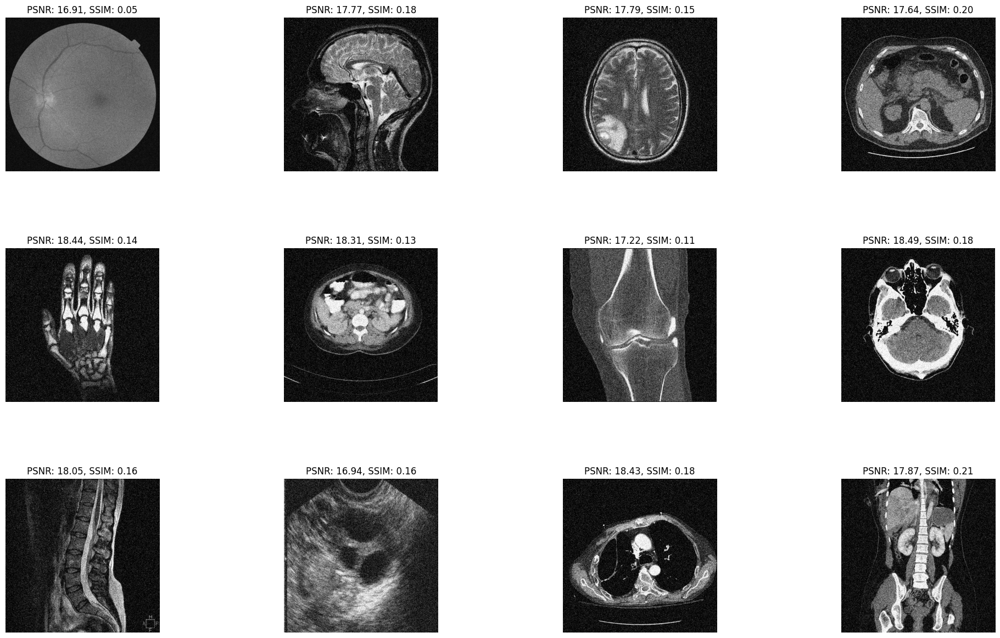

In [39]:
plot_images(denoised_gaussian_wavelet_haar_l3[0:12], med_images[0:12])

Let's increase the levels to see the result.

In [40]:
denoised_gaussian_wavelet_haar_l5 = denoise_image_wavelet_list(meds__gaussianNoise, 'haar', 5)

(17.820854516494443, 0.1530336913728286)

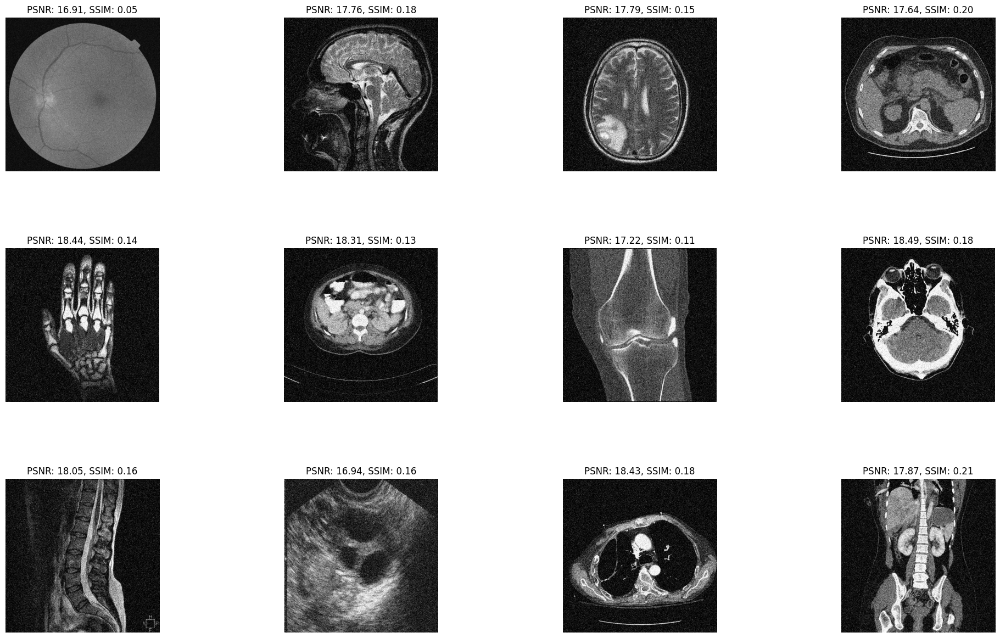

In [41]:
plot_images(denoised_gaussian_wavelet_haar_l5[0:12], med_images[0:12])

In [42]:
denoised_gaussian_wavelet_coiflet_l5 = denoise_image_wavelet_list(meds__gaussianNoise, 'coif1', 3)

(22.365038758688517, 0.5751485572292431)

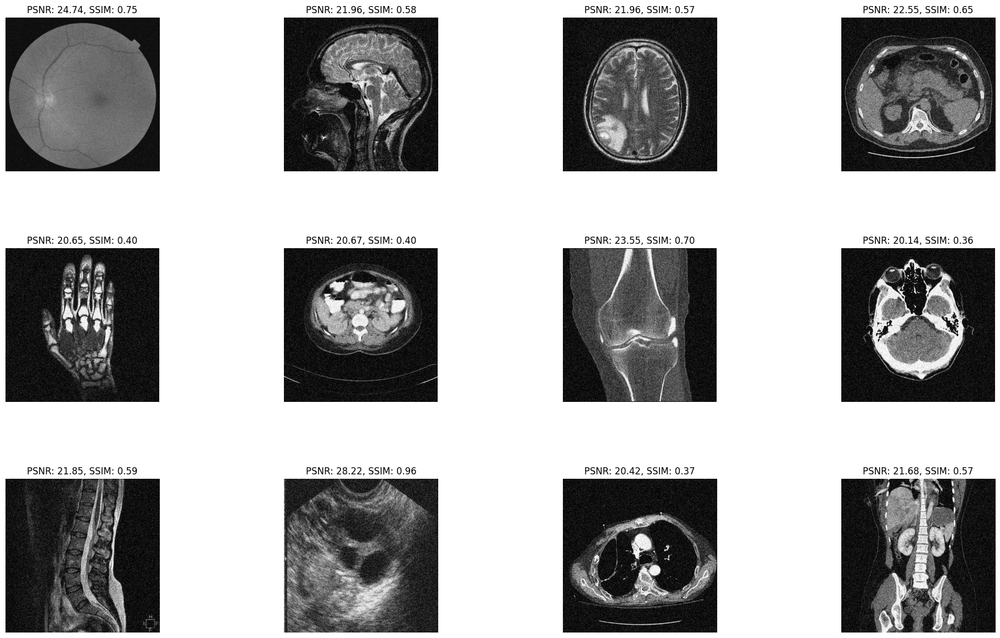

In [43]:
plot_images(denoised_gaussian_wavelet_coiflet_l5[0:12], meds__gaussianNoise[0:12])

In [48]:
# denoised_gaussian_wavelet_shannon = denoise_image_wavelet_s_list(meds__gaussianNoise)

Now, let's see the results.